# Clustering Analysis with Intervals
Notebook to perform preliminar analysis on BigQuery data.<br>
The notebook will focus on station and pollen species clustering, analyzing if and how they could be clustered.

### Data Description

Correlation is studied on 4 different tables representing datasets:
- <b>ALL_METEO_FEATS</b>: it contains all the features extracted from all_meteo.
- <b>ALL_METEO_FEATS_POL_DAT</b>: it joins the extracted features with the pol_data values.
- <b>ALL_METEO_WEEK_FEATS</b>: it contains all the features aggregated by week from all_meteo.
- <b>ALL_METEO_WEEK_FEATS_POL_DAT</b>: it joins the features aggregated by week with the pol_data values.

<h3>Import</h3>

In [1]:
from tqdm.auto import tqdm
import json
import math
import pandas as pd
import numpy as np
import datetime
from datetime import timedelta
from google.cloud import bigquery

import seaborn as sns
from collections import Counter
import matplotlib.cm as cm
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.preprocessing import MinMaxScaler

import matplotlib.pyplot as plt
from matplotlib.pyplot import get_cmap
from matplotlib import cm
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import ipywidgets as widgets
import scipy.stats
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import mean_squared_error
from plotly.offline import init_notebook_mode, iplot
from statsmodels.tsa.seasonal import seasonal_decompose

import warnings
warnings.filterwarnings('ignore')

my_cmap = plt.get_cmap("Paired")
init_notebook_mode(connected=True)  
tqdm.pandas()

In [2]:
import plotly.io as pio
pio.renderers.default='notebook'

In [3]:
from notebook.services.config import ConfigManager
#confm = ConfigManager().update('notebook', {'limit_output': 9999999999999})
#confm = ConfigManager().update('notebook', {'limit_display_data': 9999999999999})
#confm = ConfigManager().update('notebook', {'limit_execute_result': 9999999999999})
#confm = ConfigManager().update('notebook', {'limit_display_data': 9999999999999})

<h3>Config</h3>

In [4]:
# Config

PROJECT_ID = 'arpae-prod-ml'

# BigQuery
BQ_DATASET = 'SAMPLE_DATA'
JOINED_BQ_DATASET = 'JOINED_DATA'

# Paths
BCODES_PATHS = "data/b_codes.json"

TSD_COL = 'tsd_trend'

# Const
COMMON_PERIOD_INIT = '2011-01-01'
COMMON_PERIOD_END = '2021-12-31' 
#COMMON_PERIOD_YEAR = '2021'

# Feats
METEO_FEATS = ['min', 'max', 'mean', 'std']
METEO_VARS = ['B13011', 'B14198', 'PREC', 'TEMP']
FEATS = ['B13011_min', 'B13011_max', 'B13011_mean', 'B13011_std', 
         'B14198_min', 'B14198_max', 'B14198_mean', 'B14198_std', 
         'TEMP_min', 'TEMP_max', 'TEMP_mean', 'TEMP_std', 'PREC']
WEEK_FEATS = ['B13011_min', 'B13011_max', 'B13011_mean', 'B13011_std', 
              'B14198_min', 'B14198_max', 'B14198_mean', 'B14198_std', 
              'TEMP_min', 'TEMP_max', 'TEMP_mean', 'TEMP_std', 'PREC', 'PREC_sum']
SHIFT_DAYS_LIST = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

# Layout
COLOR_PALETTE = px.colors.qualitative.Prism

OUTPUT_CLUSTER_FILENAME = "../data/clustering_trend_intervals.csv"

<h3>Methods</h3>

In [5]:
# Read Methods

def _run_query(client, query): 
    df = client.query(query).to_dataframe()
    return df

def _read_table(client, project_id, dataset, table):
    query = "SELECT * FROM `{}.{}.{}` ".format(project_id, dataset, table)
    df = _run_query(client, query)
    return df

def _read_table_delta(client, project_id, dataset, table, date_col, init, end):
    query = "SELECT * FROM `{}.{}.{}` WHERE {} > '{}' AND {} < '{}' ".format(project_id, dataset, table, date_col, init, date_col, end)
    df = _run_query(client, query)
    if 'reftime' in df.columns:
        df.sort_values(by='reftime', inplace=True)
    elif date_col in df.columns:
        df.sort_values(by=date_col, inplace=True)
    else:
        return None
    return df

def _extract_date(x):
    return str(x)[:10]

def _set_var_descr(x):
    if x in b_codes:
        return b_codes[x]
    else:
        return x

def _create_temporal_aggregation_widget():
    wdgt = widgets.Dropdown(options=['year-week', 'month'], description='Aggregation:', layout={"width":"50%"})
    return wdgt
    
def _create_station_init_end_widget(df):
    station_ids = df.station_id.sort_values().unique()
    station_wdgt = widgets.Dropdown(options=station_ids, description='Station Id:', layout={"width":"50%"})
    init_wdgt = widgets.DatePicker(description='Init Date', value=datetime.date(2021,5,1))
    end_wdgt = widgets.DatePicker(description='End Date', value=datetime.date(2021,5,5))
    return station_wdgt, init_wdgt, end_wdgt

def _create_pol_var_id_widget(df):
    pol_var_ids = df.pol_var_id.sort_values().unique()
    pol_wdgt = widgets.Dropdown(options=pol_var_ids, description='Pol var id:', layout={"width":"50%"})
    return pol_wdgt

def _create_station_id_widget(df):
    station_ids = df.station_id.sort_values().unique()
    station_wdgt = widgets.Dropdown(options=station_ids, description='Station Id:', layout={"width":"50%"})
    return station_wdgt

def _create_features_widget():
    wdgt = widgets.Dropdown(options=['reduced features', 'original features'], 
                            description='Select Feats:', layout={"width":"50%"})
    return wdgt

def _create_scaling_widget():
    wdgt = widgets.Dropdown(options=['min-max-linear', 'interval'], 
                            description='Select Feats:', layout={"width":"50%"})
    return wdgt


In [6]:
# Comp Methods

def _shift_date(x, shift_days):
    date = pd.to_datetime(x)
    date = date - timedelta(days=shift_days)
    return date.strftime("%Y-%m-%d")

def _shift_week(x, shift):
    return x-shift

def _extract_month_year(x):
    return x[:7]

def _extract_week_year(x):
    return str(x['date'][:4])+"-"+str(x['week'])

def _normalize(x, range_dict, col):
    pol_min = range_dict[x['pol_var_id']]['min']
    pol_max = range_dict[x['pol_var_id']]['max']
    return (x[col] - pol_min) / (pol_max - pol_min)

def _set_range_value(x, pol_var_id_range):    
    for i, interval in enumerate(pol_var_id_range[x['pol_var_id']]):
        if x['pol_value'] <= interval:
            return i
    return None


In [7]:
# Plot Methods
    
def _show_pollen_trend_in_cluster(df, x_col, y_col, sort_cols):
    for cluster_id in sorted(df.cluster.unique()):
        curr_df = df[df["cluster"]==cluster_id]        
        curr_df.sort_values(by=sort_cols, inplace=True)
        curr_df['station_id'] = curr_df['station_id'].astype(str)
        curr_df['station_id_pol_var_id'] = curr_df.apply(lambda x: x['station_id']+"-"+x['pol_var_id'], axis=1)
        fig = go.Figure()
        fig = px.scatter(title="Cluster: {} with {} stations".format(cluster_id, 
                                                                     str(curr_df.station_id.nunique())),
                         data_frame=curr_df,
                         x=x_col, 
                         y=y_col,
                         color='station_id_pol_var_id',
                         hover_name='station_id_pol_var_id',
                         color_discrete_sequence=COLOR_PALETTE,
                         template="simple_white")
        fig.update_traces(marker=dict(size=3), mode="lines+markers")
        fig.update_xaxes(title_text='datetime', showgrid=True)
        fig.update_yaxes(title_text='val', showgrid=True)
        fig.show()       
        
def _show_distr_in_clusters(df, col, title):
    df_list = []
    for cluster_id in sorted(df.cluster.unique()):
        curr_df = df[df["cluster"]==cluster_id]
        station_dict = {}
        for station_id in curr_df[col].unique():
            station_dict[station_id] = curr_df[col].values.tolist().count(station_id)
        df_list.append(station_dict)
    station_distr_df = pd.DataFrame(df_list)

    fig = px.imshow(station_distr_df, text_auto=True, title='{} distribution in clusters'.format(title))
    fig.update_xaxes(title_text=title, tickmode='linear')
    fig.update_yaxes(title_text='Clusters', tickmode='linear')
    fig.show()
    
def _show_bcode_in_how_many_clusters(df):
    bcode_distr = {}
    for pol_var_id in sorted(df.pol_var_id.unique()):
        curr_df = df[df["pol_var_id"]==pol_var_id]
        bcode_distr[pol_var_id] = curr_df['cluster'].nunique()
    bcode_distr = dict(sorted(bcode_distr.items(), key=lambda item: item[1]))

    fig = go.Figure()
    fig = px.bar(title="",
                 x=bcode_distr.keys(), 
                 y=bcode_distr.values(),
                 color_discrete_sequence=COLOR_PALETTE,
                 template="simple_white")
    fig.update_xaxes(title_text='b_code', showgrid=True)
    fig.update_yaxes(title_text='in how many cluster', showgrid=True, tickmode='linear', 
                     range=[0, df.cluster.nunique()])
    fig.show()
    

<h3>1. Config</h3>

<h4>1.1 Config BigQuery</h4>

In [8]:
# Setup Client

bq_client = bigquery.Client(project=PROJECT_ID)
bq_client

<h3>2. Read Data</h3>

<h4>2.1 Read Tables</h4>

<b>ALL_METEO_FEATS</b> contains features extracted by meteo values on daily aggregation, such as: min, max, mean, std values for B13, B14, TEMP and PREC.

In [9]:
# Read ALL_METEO_FEATS

all_meteo_feats_df = _read_table_delta(bq_client, PROJECT_ID, JOINED_BQ_DATASET, 
                                       "ALL_METEO_FEATS", "date",
                                       COMMON_PERIOD_INIT, COMMON_PERIOD_END)
all_meteo_feats_df['date'] = all_meteo_feats_df['date'].astype("str")
print(all_meteo_feats_df.shape)
all_meteo_feats_df.head(3)

(40666, 28)


,station_id,date,B13011_min,B13011_max,B13011_mean,B13011_std,B13011_sum,B14198_min,B14198_max,B14198_mean,...,id_gepo,station_lat,station_lon,station_nome,station_H_piano_strada,station_H_mslm,arkimet_id,arkimet_lat,arkimet_lon,meteo_id
27737,7,2011-01-02,0.0,0.0,0.000000,0.000000,0.0,-11.0,141.0,25.84,...,4177,44.8092,10.3267,Parma,50.0,71.0,Parma urbana,44.8080,10.3305,00774
20256,5,2011-01-02,0.0,0.0,0.000000,0.000000,0.0,-7.0,160.0,30.92,...,4186,44.2180,12.0328,Forlì,30.0,51.0,Forli' urbana,44.2204,12.0418,01867
4140,11,2011-01-02,0.0,0.2,0.001176,0.015339,0.2,-5.0,289.0,29.72,...,4188,44.0450,12.5914,Rimini,7.0,28.0,Rimini urbana,44.0592,12.5735,02231


<b>ALL_METEO_FEATS_POL_DAT</b> joins features ALL_METEO_FEATS with POL_DAT.

In [10]:
# Read ALL_METEO_FEATS_POL_DAT

all_meteo_feats_pol_dat_df = _read_table_delta(bq_client, PROJECT_ID, JOINED_BQ_DATASET, 
                                               "ALL_METEO_FEATS_POL_DAT", "date",
                                               COMMON_PERIOD_INIT, COMMON_PERIOD_END)
all_meteo_feats_pol_dat_df['date'] = all_meteo_feats_pol_dat_df['date'].astype("str")
print(all_meteo_feats_pol_dat_df.shape)
all_meteo_feats_pol_dat_df.head(3)

(920108, 33)


,station_id,date,B13011_min,B13011_max,B13011_mean,B13011_std,B13011_sum,B14198_min,B14198_max,B14198_mean,...,arkimet_id,arkimet_lat,arkimet_lon,meteo_id,pol_var_id,pol_value,modified,pol_var_descr,week,year
340130,1,2011-01-02,0.0,0.0,0.000000,0.000000,0.0,-8.0,149.0,27.48,...,Bologna urbana,44.5008,11.3288,01421,B48008,0.0,1,"Corilacee_Nocciolo, POLLEN/M**3",1,2011
547444,11,2011-01-02,0.0,0.2,0.001176,0.015339,0.2,-5.0,289.0,29.72,...,Rimini urbana,44.0592,12.5735,02231,B48003,0.0,1,"Betulacee_Betulla, POLLEN/M**3",1,2011
252376,10,2011-01-02,0.0,0.0,0.000000,0.000000,0.0,-7.0,141.0,24.08,...,Reggio nell'Emilia urbana,44.6978,10.6337,00977,B48003,0.0,1,"Betulacee_Betulla, POLLEN/M**3",1,2011


<b>ALL_METEO_WEEK_FEATS_POL_DAT</b> joins features ALL_METEO_WEEK_FEATS with POL_DAT, aggregated by week.

In [11]:
# Read ALL_METEO_WEEK_FEATS_POL_DAT

all_meteo_week_feats_pol_dat_df = _read_table_delta(bq_client, PROJECT_ID, JOINED_BQ_DATASET, 
                                                    "ALL_METEO_WEEK_FEATS_POL_DAT", "init_date",
                                                    COMMON_PERIOD_INIT, COMMON_PERIOD_END)
print(all_meteo_week_feats_pol_dat_df.shape)
all_meteo_week_feats_pol_dat_df.head(3)

(140149, 32)


,station_id,week,year,init_date,end_date,B13011_min,B13011_max,B13011_mean,B13011_std,B14198_min,...,station_H_piano_strada,station_H_mslm,arkimet_id,arkimet_lat,arkimet_lon,meteo_id,pol_var_id,pol_var_descr,POL_mean,POL_sum
13210,6,1,2011,2011-01-02,2011-01-08,0.0,0.6,0.002521,0.032195,-13.0,...,28.0,49.0,Modena urbana,44.6564,10.9170,01138,B48021,Cupressacee - Taxacee indistinte_Cupressacee -...,0.691429,4.84
86844,2,1,2011,2011-01-02,2011-01-08,0.0,0.0,0.000000,0.000000,-7.0,...,31.0,52.0,Cesena urbana,44.1382,12.2436,01989,B48016,"Oleacee_Frassino, POLLEN/M**3",0.000000,0.00
24186,9,1,2011,2011-01-02,2011-01-08,0.0,0.0,0.000000,0.000000,-7.0,...,2.0,23.0,Ravenna urbana,44.4150,12.2000,01983,B48016,"Oleacee_Frassino, POLLEN/M**3",0.048571,0.34


<h3>3. Prepare Data</h3>

To perform cluster:
- we normalize pollen values for each pol_var_id
- we aggregate data for months, extracting some features
- we create a dataset and the pivoted dataset

In [12]:
#FEATS = ['min', 'max', 'mean', 'std', 'sum']
FEATS = ['sum']

<h4>3.1 Prepare Input Data</h4>

In [13]:
# Get Pollen df

pol_df = all_meteo_feats_pol_dat_df[['station_id', 'date', 'week', 'pol_var_id', 'pol_value']]
pol_df['month'] = pol_df['date'].apply(lambda x: _extract_month_year(x))
pol_df['year-week'] = pol_df.apply(lambda x: _extract_week_year(x), axis=1)
print(pol_df.shape)
pol_df.head(3)

(920108, 7)


,station_id,date,week,pol_var_id,pol_value,month,year-week
340130,1,2011-01-02,1,B48008,0.0,2011-01,2011-1
547444,11,2011-01-02,1,B48003,0.0,2011-01,2011-1
252376,10,2011-01-02,1,B48003,0.0,2011-01,2011-1


In [14]:
# Create dataset to process

df_dataset = pol_df.copy()

<h4>3.2 Pollen Values Normalization</h4>

To extract the trend despite the value range of different species, we need to scale each pol_var_id using the min and the max of that species.<br>
We perform the normalization in two different ways, that can be selected from the widget below:
- min-max-scaler: scale all data with the classic min-max-scaler method
- interval: it create 5 interval for each pol_var_id and assign values in one of the interval.

The advantage of the second method is that it normalize the different ranges of the species: two species where max values are 10.000 or 100 can be potentially both clustered in the same cluster since their max value is 5.

In [15]:
scaling_wdgt = _create_scaling_widget()
display(scaling_wdgt)

Dropdown(description='Select Feats:', layout=Layout(width='50%'), options=('min-max-linear', 'interval'), valu…

In [16]:
if scaling_wdgt.value == 'min-max-linear':
    # Min-Max scaling for each pol_var_id
    range_df = df_dataset[['pol_var_id', 'pol_value']].groupby('pol_var_id').agg(['min', 'max'])
    pol_var_id_range = {}
    for index, values in zip(range_df.index, range_df.values):
        pol_var_id_range[index] = {'min': values[0], 'max': values[1]}
    df_dataset['pol_value_std'] = df_dataset.apply(lambda x: _normalize(x, pol_var_id_range, 'pol_value'), axis=1)
    
elif scaling_wdgt.value == 'interval':
    # Range scaling for each pol_var_id: create, for each pol_var_id 5 values interval to put in values 
    range_df = df_dataset[['pol_var_id', 'pol_value']].groupby('pol_var_id').agg(['min', 'max'])
    pol_var_id_range = {}
    for index, values in zip(range_df.index, range_df.values):
        pol_var_id_range[index] = np.linspace(values[0], values[-1], 5)
    df_dataset['pol_value_std'] = df_dataset.apply(lambda x: _set_range_value(x, pol_var_id_range), axis=1)
    
else:
    print("Error on widget.")

<h4>3.3 Extract TSD Trend</h4>

For each station and bcode, we can extract its trend.<br>
The label column will be replaced by the trend, so that a model can be trained to predict the (station, bcode) trend over the year.

In [17]:
# Get Trend foreach station_id & pol_var_id

df_list = []
for pol_var_id in df_dataset.pol_var_id.unique():
    try:
        df = df_dataset[df_dataset['pol_var_id']==pol_var_id]
        if df.shape[0] == 0:
            continue
        df.sort_values(by='date', inplace=True)            
        # tsd
        result = seasonal_decompose(df['pol_value_std'], model='additive', period=365)
        # add cols        
        df[TSD_COL] = result.trend.values
        df_list.append(df)
    except:
        continue
        
df_dataset = pd.concat(df_list)
df_dataset.dropna(inplace=True)
print(df_dataset.shape)
df_dataset.head(3)

(908096, 9)


,station_id,date,week,pol_var_id,pol_value,month,year-week,pol_value_std,tsd_trend
57023,6,2011-01-19,3,B48008,0.88,2011-01,2011-3,0.002326,0.003205
258541,10,2011-01-19,3,B48008,0.00,2011-01,2011-3,0.000000,0.003300
148174,11,2011-01-19,3,B48008,1.10,2011-01,2011-3,0.002907,0.003343


<h4>3.3 TSD Normalization</h4>

In [18]:
# Min-Max scaling for each pol_var_id
range_df = df_dataset[['pol_var_id', TSD_COL]].groupby('pol_var_id').agg(['min', 'max'])
pol_var_id_range = {}
for index, values in zip(range_df.index, range_df.values):
    pol_var_id_range[index] = {'min': values[0], 'max': values[1]}
df_dataset[TSD_COL] = df_dataset.apply(lambda x: _normalize(x, pol_var_id_range, TSD_COL), axis=1)

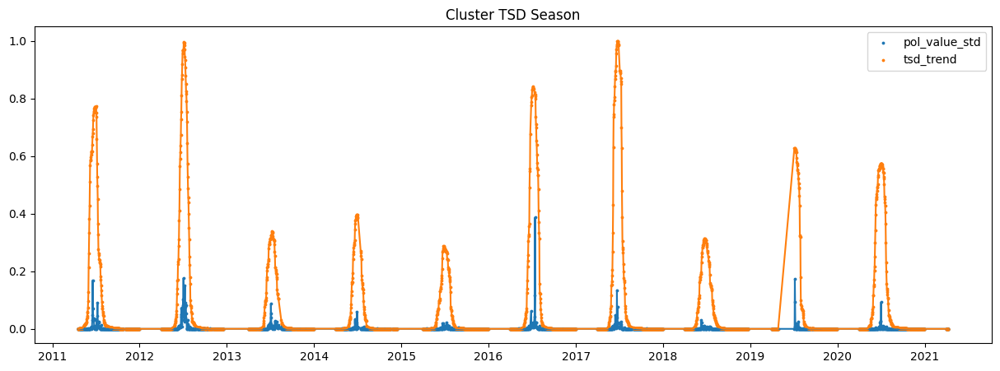

In [19]:
# Plot random trends

comb = df_dataset.sample(1)[['station_id', 'pol_var_id']].values
plt.figure(figsize=(15, 5))
plt.title("Cluster TSD Season")
for station_id, pol_var_id in comb:
    df = df_dataset[(df_dataset['station_id']==station_id) & (df_dataset['pol_var_id']==pol_var_id)]
    df['date'] = pd.to_datetime(df['date'])
    df.sort_values(by='date', inplace=True)
    plt.scatter(df['date'], df['pol_value_std'], s=3, label='pol_value_std')
    plt.plot(df['date'], df['pol_value_std'])
    plt.scatter(df['date'], df[TSD_COL], s=3, label=TSD_COL)
    plt.plot(df['date'], df[TSD_COL])
plt.legend()
plt.show()

<h4>3.4 Extract temporal features</h4>

In [20]:
# Aggregate per month or per week

aggregation_wdgt = _create_temporal_aggregation_widget()
display(aggregation_wdgt)

Dropdown(description='Aggregation:', layout=Layout(width='50%'), options=('year-week', 'month'), value='year-w…

In [21]:
if aggregation_wdgt.value == 'month':
    # Extract month feats
    df_dataset = df_dataset.groupby(['station_id', 'month', 'pol_var_id'])[TSD_COL].agg(FEATS).reset_index()
    print(df_dataset.shape)
    df_dataset.head(3)
    
elif aggregation_wdgt.value == 'year-week':
    df_dataset = df_dataset.groupby(['station_id', 'year-week', 'pol_var_id'])[TSD_COL].agg(FEATS).reset_index()
    print(df_dataset.shape)
    df_dataset.head(3)
    
else:
    print("Error.")

(138332, 4)


<h4>3.4 Create the pivoted dataset</h4>

In [22]:
# Pivot df 

df_dataset_t = pd.pivot_table(df_dataset, values=FEATS, index=['station_id', 'pol_var_id'], 
                              columns=aggregation_wdgt.value)
df_dataset_t = df_dataset_t.reset_index()
df_dataset_t.columns = ["_".join(x) for x in df_dataset_t.columns.ravel()]
df_dataset_t.rename(columns={'station_id_':'station_id', 'pol_var_id_':'pol_var_id'}, inplace=True)
df_dataset_t.fillna(0.0, inplace=True)
print(df_dataset_t.shape)
df_dataset_t.head(3)

(363, 577)


,station_id,pol_var_id,sum_2011-10,sum_2011-11,sum_2011-12,sum_2011-13,sum_2011-14,sum_2011-15,sum_2011-16,sum_2011-17,...,sum_2021-43,sum_2021-44,sum_2021-45,sum_2021-46,sum_2021-47,sum_2021-5,sum_2021-6,sum_2021-7,sum_2021-8,sum_2021-9
0,1,B48001,0.000000,0.022584,0.220397,0.706486,2.025361,3.977994,5.123697,5.909920,...,0.029685,0.009629,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.022326
1,1,B48002,1.485562,1.163067,1.064612,0.875418,0.515594,0.118619,0.060488,0.041631,...,0.000000,0.000000,0.0,0.0,0.0,0.489978,0.836682,0.963969,1.033064,1.042357
2,1,B48003,0.126586,0.408559,3.252501,6.537679,6.905396,6.981411,6.410222,2.573840,...,0.000000,0.000000,0.0,0.0,0.0,0.015028,0.018323,0.021930,0.022693,0.032939


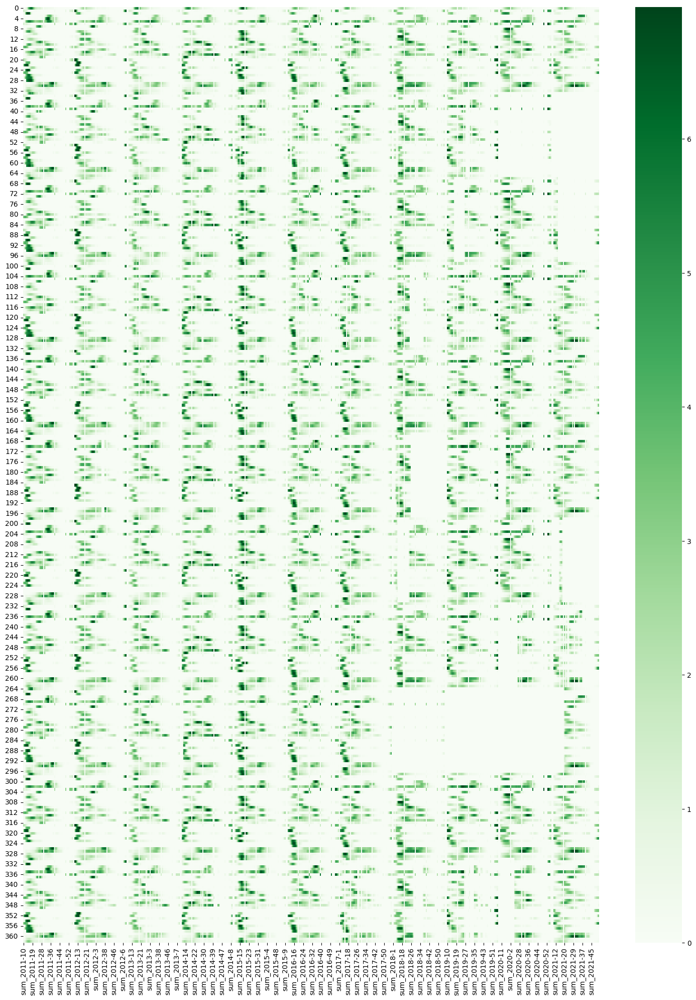

In [23]:
# Show Features Heatmap

plt.figure(figsize=(15, 20))
sns.heatmap(df_dataset_t.drop(columns=['station_id', 'pol_var_id']), cmap="Greens");
plt.tight_layout();

<h4>3.5 Create features dataset</h4>

In [24]:
# Create Dataset with only features

df_features_orig = df_dataset_t.drop(columns=['station_id', 'pol_var_id'])
df_features_orig.shape

(363, 575)

<h3>4. Reduce Dimensionality with PCA</h3>

In [25]:
# Apply PCA

pca = PCA(n_components=3)
pca_components = pca.fit_transform(df_features_orig)
total_var = pca.explained_variance_ratio_.sum() * 100

In [26]:
# Create dataframe 

df_features_pca = pd.DataFrame(pca_components, columns=['pca_0', 'pca_1', 'pca_2'])
print(df_features_pca.shape)
df_features_pca.head(3)

(363, 3)


,pca_0,pca_1,pca_2
0,1.433179,19.342829,-4.981686
1,-13.263537,-15.782852,-4.779202
2,-13.192624,4.937370,8.561665


<h3>5. Clustering</h3>

Perform clustering on each <b><station_id, pol_var_id></b> combo.<br>
<b>Choose here</b> if run clustering on:
- <b>original features</b> or
- <b>reduced features</b>

In [27]:
# Create widget 

features_wdgt = _create_features_widget()
display(features_wdgt)

Dropdown(description='Select Feats:', layout=Layout(width='50%'), options=('reduced features', 'original featu…

In [28]:
# Select one of the following

if features_wdgt.value == 'original features':
    df_features = df_features_orig
elif features_wdgt.value == 'reduced features':
    df_features = df_features_pca
else:
    print("Error on widget.")

<h4>5.1 Get optimal cluster number</h4>

For each K number of cluster, we compute: 
- the Knee-elbow value
- the Silhouette Score: the best case is where value is 1; 0 means overlapping clusters.

In [45]:
# Get Cluster Number with Knee-Elbow Analysis

wcss, silhouette_scores = [], []
cluster_ranges = list(range(2, 50))
for i in tqdm(cluster_ranges):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(df_features)
    wcss.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(df_features, kmeans.labels_))

fig = go.Figure()
fig = px.scatter(title="Knee-Elbow Analysis",
                 x=cluster_ranges, 
                 y=wcss,
                 template="simple_white")
fig.update_traces(marker=dict(size=6), mode="markers+lines")
fig.update_xaxes(title_text='Number of clusters', showgrid=True, tickmode='linear')
fig.update_yaxes(title_text='WCSS', showgrid=True)
fig.show()

fig = go.Figure()
fig = px.scatter(title="Silhouette Score",
                 x=cluster_ranges, 
                 y=silhouette_scores,
                 template="simple_white")
fig.update_traces(marker=dict(size=6), mode="markers+lines")
fig.update_xaxes(title_text='Number of clusters', showgrid=True, tickmode='linear')
fig.update_yaxes(title_text='Silhouette Score', showgrid=True)
fig.show()

  0%|          | 0/48 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

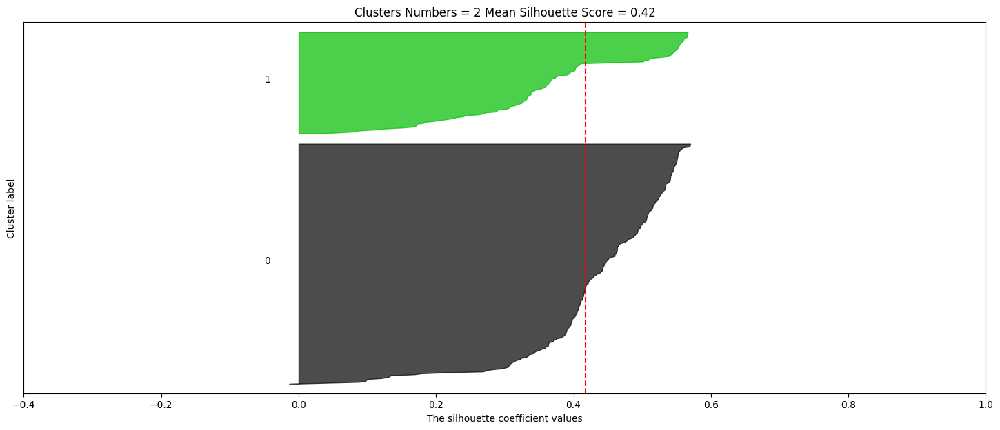

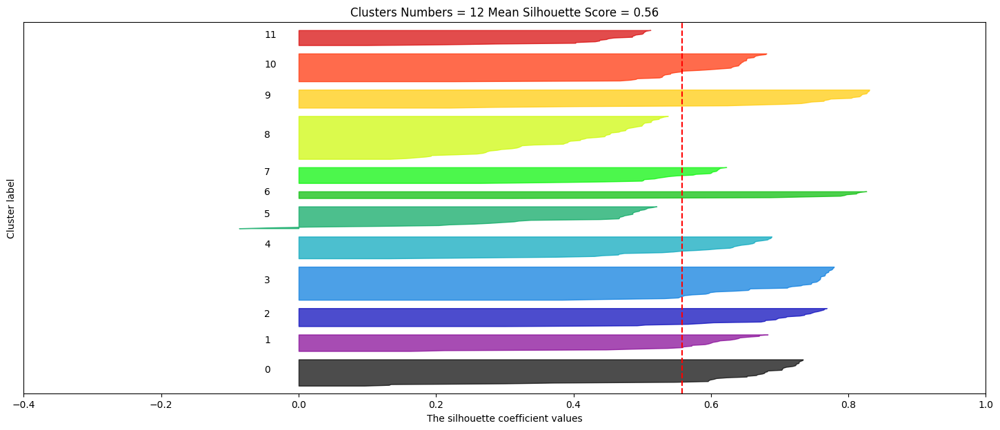

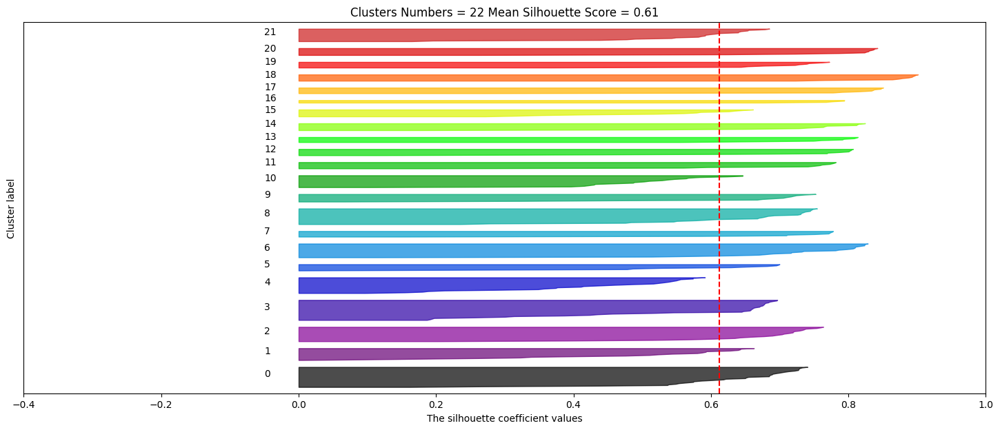

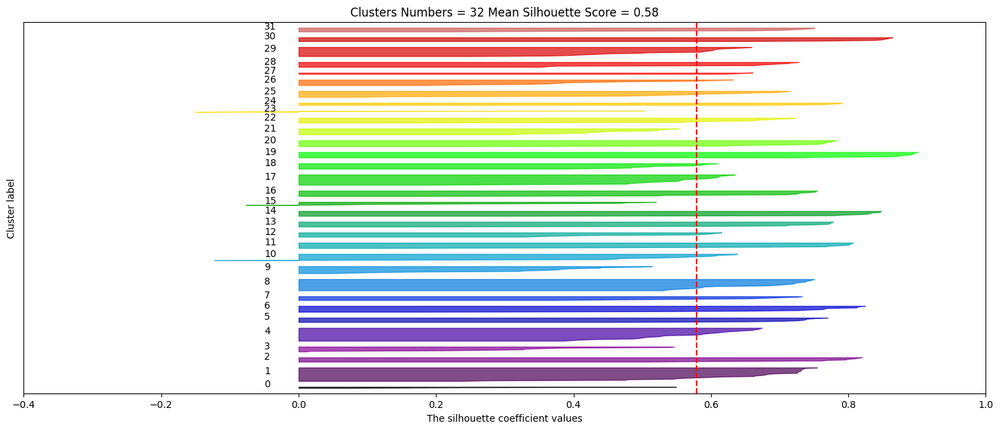

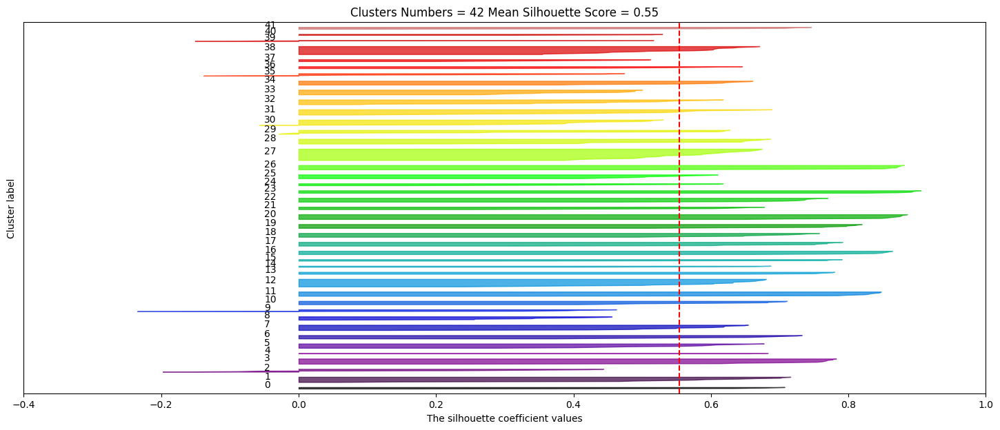

In [30]:
X = df_features

for n_clusters in tqdm(range(2, 50, 10)):
    fig, (ax1) = plt.subplots(1)
    fig.set_size_inches(18, 7)
    ax1.set_xlim([-0.3, 1])
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])
    # clustering
    clusterer = KMeans(n_clusters=n_clusters)
    cluster_labels = clusterer.fit_predict(X)
    # get silhouette
    silhouette_avg = silhouette_score(X, cluster_labels)
    # plot
    y_lower = 10
    sample_silhouette_values = silhouette_samples(X, cluster_labels)
    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, 
                          facecolor=color, edgecolor=color, alpha=0.7)
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10  # 10 for the 0 samples
    ax1.set_title("Clusters Numbers = {} Mean Silhouette Score = {}".format(n_clusters, 
                                                                            np.round(silhouette_avg, 2)))
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8, 1])
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)

plt.show()

In [31]:
# Set Elbow at n clusters

n_optimal = 10

<h4>5.2 Perform Clustering</h4>

In [32]:
# Perform Clustering

clusterer = KMeans(n_clusters=n_optimal)
cluster_labels = clusterer.fit_predict(df_features)

<h4>5.3 Assign Cluster to both dataset and to daily data</h4>

In [33]:
# Assign Clusters to df_dataset 

df_dataset_t['cluster'] = cluster_labels
df_dataset = pd.merge(df_dataset, df_dataset_t[['station_id', 'pol_var_id', 'cluster']])
df_dataset.reset_index(drop=True, inplace=True)
print(df_dataset.shape)
df_dataset.head(3)

(138332, 5)


,station_id,year-week,pol_var_id,sum,cluster
0,1,2011-10,B48002,1.485562,3
1,1,2011-11,B48002,1.163067,3
2,1,2011-12,B48002,1.064612,3


In [34]:
# Assign Clusters to pivoted df_dataset_t

df_dataset_t['cluster'] = cluster_labels
print(df_dataset_t.shape)
df_dataset_t.head(3)

(363, 578)


,station_id,pol_var_id,sum_2011-10,sum_2011-11,sum_2011-12,sum_2011-13,sum_2011-14,sum_2011-15,sum_2011-16,sum_2011-17,...,sum_2021-44,sum_2021-45,sum_2021-46,sum_2021-47,sum_2021-5,sum_2021-6,sum_2021-7,sum_2021-8,sum_2021-9,cluster
0,1,B48001,0.000000,0.022584,0.220397,0.706486,2.025361,3.977994,5.123697,5.909920,...,0.009629,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.022326,4
1,1,B48002,1.485562,1.163067,1.064612,0.875418,0.515594,0.118619,0.060488,0.041631,...,0.000000,0.0,0.0,0.0,0.489978,0.836682,0.963969,1.033064,1.042357,3
2,1,B48003,0.126586,0.408559,3.252501,6.537679,6.905396,6.981411,6.410222,2.573840,...,0.000000,0.0,0.0,0.0,0.015028,0.018323,0.021930,0.022693,0.032939,0


In [35]:
# Assign Clusters to original data

pol_df = pd.merge(df_dataset, pol_df)
print(pol_df.shape)
pol_df.head(3)

(910157, 9)


,station_id,year-week,pol_var_id,sum,cluster,date,week,pol_value,month
0,1,2011-10,B48002,1.485562,3,2011-03-06,10,6.45,2011-03
1,1,2011-10,B48002,1.485562,3,2011-03-07,10,11.18,2011-03
2,1,2011-10,B48002,1.485562,3,2011-03-08,10,1.29,2011-03


<h3>6. Clusters Analysis</h3>

<h4>6.1 Show Pollen Trend in Cluster</h4>

In [46]:
# Show Pollen Sum for Month Aggregated Data:
# qui rimane sballat perche non lo prende come settimana secondo me?

df_dataset['date'] = df_dataset['year-week'].apply(lambda x: datetime.datetime.strptime(x + '-1', "%Y-%W-%w"))
_show_pollen_trend_in_cluster(df_dataset, 'date', 'sum', sort_cols=['date'])

In [37]:
# Show Pollen Values for Daily Data

_show_pollen_trend_in_cluster(pol_df, 'date', 'pol_value', sort_cols=['date'])

<h4>6.2 Show Station and BCodes Distribution in Clusters</h4>

In [38]:
# Show Stations Distribution in Clusters

_show_distr_in_clusters(df_dataset, 'station_id', 'Stations')

In [39]:
# Show Stations Distribution in Clusters

_show_distr_in_clusters(df_dataset, 'pol_var_id', 'B Code')

In [40]:
# In How many Cluster we can find each BCode
    
_show_bcode_in_how_many_clusters(df_dataset)

<h4>6.3 Plot PCA with Cluster ID</h4>

In [41]:
# Plot PCA coloured by cluster

total_var = pca.explained_variance_ratio_.sum() * 100
fig = px.scatter_3d(pca_components, 
                    title=f'Total Explained Variance: {total_var:.2f}%',
                    x=0, y=1, z=2, 
                    color=df_dataset_t['cluster'].astype(str),    
                    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'})
fig.show()

<h4>6.4 Show Clusters Silouette</h4>

In [42]:
# Assign X alway to reduced data, in order to plot on almost 2 axis

X = df_features_pca

Clusters Numbers = 10 Mean Silhouette Score = 0.53


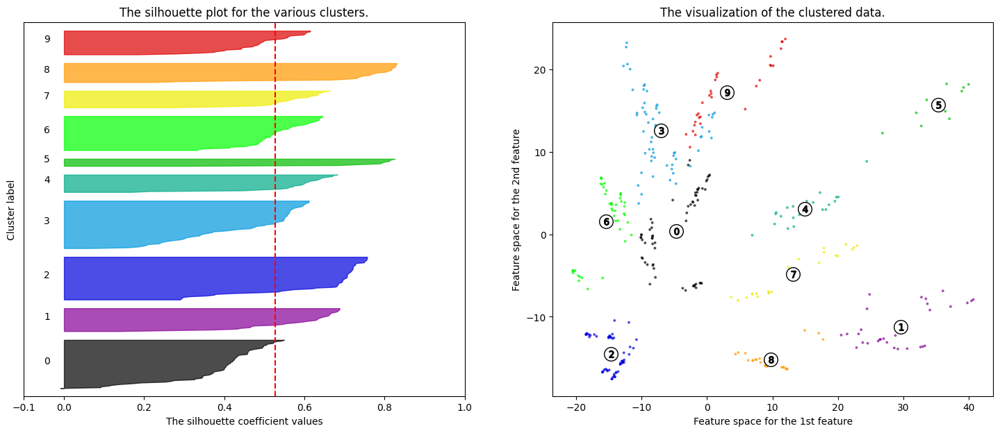

In [43]:
# Plot

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(18, 7)
ax1.set_xlim([-0.1, 1])
ax1.set_ylim([0, len(X) + (n_optimal + 1) * 10])

clusterer = KMeans(n_clusters=n_optimal)
cluster_labels = clusterer.fit_predict(X)

silhouette_avg = silhouette_score(X, cluster_labels)
print("Clusters Numbers = {} Mean Silhouette Score = {}".format(n_optimal, np.round(silhouette_avg, 2)))

y_lower = 10
sample_silhouette_values = silhouette_samples(X, cluster_labels)
for i in range(n_optimal):
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.nipy_spectral(float(i) / n_optimal)
    ax1.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    y_lower = y_upper + 10  # 10 for the 0 samples

ax1.set_title("The silhouette plot for the various clusters.")
ax1.set_xlabel("The silhouette coefficient values")
ax1.set_ylabel("Cluster label")
ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
ax1.set_yticks([])  # Clear the yaxis labels / ticks
ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
colors = cm.nipy_spectral(cluster_labels.astype(float) / n_optimal)
ax2.scatter(X[X.columns[0]].values, X[X.columns[1]].values, marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k")

centers = clusterer.cluster_centers_
ax2.scatter(centers[:, 0], centers[:, 1], marker="o", c="white", alpha=1, s=200, edgecolor="k")

for i, c in enumerate(centers):
    ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")
ax2.set_title("The visualization of the clustered data.")
ax2.set_xlabel("Feature space for the 1st feature")
ax2.set_ylabel("Feature space for the 2nd feature")

plt.show()


<h3>7. Save Clusters Results</h3>

In [44]:
# Save to disk

df_dataset_t[['station_id', 'pol_var_id', 'cluster']].to_csv(OUTPUT_CLUSTER_FILENAME)